# Speech Diarization: JJ Reddick Podcast

J.J. Reddick, a former Sixer, has an [podcast](https://www.theringer.com/the-jj-redick-podcast) in which he interviews NBA players, GMs and celebrities. On one of my favorite episodes [Elton Brand](https://www.youtube.com/watch?v=qmvKCsLeKUM), the GM of 76ers, talks about basketball, life, and his transition to becoming a GM. I was curious what percentage of the episode did JJ speak compared to his guests. This question can be framed as a machine learning problem. In short, the task is to process audio signal data, identify speech among all the sounds like music and silence and attribute speech to speakers. 

The attribution of speech is called Speech Diarization and is a common problem in machine learning. I stumbled upon [this paper](https://ieeexplore.ieee.org/document/6171836?arnumber=6171836&abstractAccess=no&userType=inst) that also had a Python implementation of a speech diarization algorithm in the [`pyAudioAnalysis`](https://github.com/tyiannak/pyAudioAnalysis) module. So, in this post I will show how to download the audio of JJ's podcast, process it in Python and find out who spoke when.

Before I start below are the packages required.

```
pip install youtube-dl librosa pandas
```

**pyAudioAnalysis**
```
pip install numpy matplotlib scipy sklearn hmmlearn simplejson eyed3 pydub
git clone https://github.com/tyiannak/pyAudioAnalysis.git
cd pyAudioAnalysis
pip install -e .
```

For video manipulation and conversion, I use the `ffmpeg`. You could also use`avconv`.
```
sudo apt install ffmpeg
```

In [2]:
%matplotlib inline 
# show plots inside jupyter

## Get the Audio File

JJ posts his podcasts on Youtube. Using `youtube-dl` we can obtain the audio file given the video link.

In [3]:
import youtube_dl
import os

ydl_opts = {
    'format': '140', # specify file format. 140 is m4a audio file
}

with youtube_dl.YoutubeDL(ydl_opts) as ydl:
    ydl.download(['https://www.youtube.com/watch?v=qmvKCsLeKUM']) # Elton Brand Episode
    
# rename file
for filename in os.listdir("."):
    if filename.startswith("Elton"):
        os.rename(filename, 'jj-eb-podcast.m4a')

[youtube] qmvKCsLeKUM: Downloading webpage
[youtube] qmvKCsLeKUM: Downloading video info webpage
[download] Destination: Elton Brand on the Sterling-Era Clippers and His Path to GM _ The JJ Redick Podcast (Ep. 23)-qmvKCsLeKUM.m4a
[download] 100% of 47.30MiB in 00:1028MiB/s ETA 00:00known ETA
[ffmpeg] Correcting container in "Elton Brand on the Sterling-Era Clippers and His Path to GM _ The JJ Redick Podcast (Ep. 23)-qmvKCsLeKUM.m4a"


One of the most common audio file types when it comes to audio processing is `wav` and thats the file format most audio analysis modules accept. I will convert `m4a` to `wav` using `ffmpeg`. I know that calling shell from Python is frowned upon and `ffmpeg` has [Python bindings](https://github.com/kkroening/ffmpeg-python). Dont judge.

In [3]:
# convert m4a to wav
os.system('ffmpeg -i jj-eb-podcast.m4a jj-eb-podcast.wav')

0

So, the resulting `wav` file is 540 MBs. Makes sense since its 50  minutes long. I will break it up into 10 minute (600 seconds) intervals using below command

In [8]:
os.makedir('jj-eb-podcast-chunks')
os.system('ffmpeg -i jj-eb-podcast.wav -f segment -segment_time 600 -c copy jj-eb-podcast-chunks/jj-eb-podcast%03d.wav')

0

Now, I have 6 files of 100 MBs and smaller in the `jj-eb-podcast-chunks`

In [16]:
! ls -l jj-eb-podcast-chunks --block-size=M

total 516M
-rw-rw-r-- 1 koba koba 101M Mar 20 00:12 jj-eb-podcast000.wav
-rw-rw-r-- 1 koba koba 101M Mar 20 00:12 jj-eb-podcast001.wav
-rw-rw-r-- 1 koba koba 101M Mar 20 00:12 jj-eb-podcast002.wav
-rw-rw-r-- 1 koba koba 101M Mar 20 00:12 jj-eb-podcast003.wav
-rw-rw-r-- 1 koba koba 101M Mar 20 00:12 jj-eb-podcast004.wav
-rw-rw-r-- 1 koba koba  11M Mar 20 00:12 jj-eb-podcast005.wav


## Speaker Diarization
Thanks to `pyAudioAnalysis` the actual speech attribution takes three lines of code.

/home/koba/anaconda/envs/mypython3/lib/python3.6/site-packages/sklearn/ensemble/weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d
/home/koba/anaconda/envs/mypython3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:442: UserWarning: The priors do not sum to 1. Renormalizing
  UserWarning)


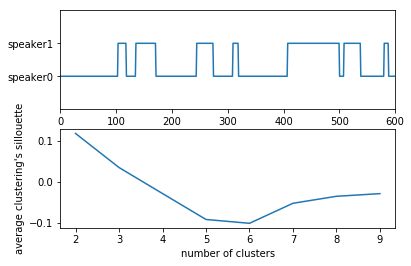

In [7]:
from pyAudioAnalysis import audioSegmentation as aS

# Process the first 10 minutes (600 seconds)
r = aS.speakerDiarization("jj-eb-podcast-chunks/jj-eb-podcast000.wav",n_speakers = -1, mt_step=1,plot_res=True)

The `speakerDiarization` function provides helpful plots. In the first one we can see the time intervals during which the two basketball stars spoke. The second one shows the silhouette score which helps choose the optimal number of clusters. I passed -1 to the `n_speakers` parameter meaining I let the algorithm decide the optimal number of speakers. The `mt_step` parameter or mid-term window step size defines the length of each audioframe in seconds. For longer audio files it makes sense to use values greater than 1 second. 

The resulting array `r` contains speaker ids for each second of the audio file, so it contains 600 items since the audio file is 600 seconds long.

In [15]:
{int(value): list(r).count(value) for value in set(r)}
# len(r) is 600

{0: 379, 1: 222}

Let's look at chunks in which we can hear the voices of speaker 0 and speaker 1. The `repeatingNumbers` function will help identify the intervals.

In [7]:
def repeatingNumbers(numList):
    i = 0
    while i < len(numList) - 1:
        n = numList[i]
        startIndex = i
        while i < len(numList) - 1 and numList[i] == numList[i + 1]:
            i = i + 1

        endIndex = i

        print("{0} >> {1}".format(n, [startIndex, endIndex]))
        i = i + 1

repeatingNumbers(r)

0.0 >> [0, 102]
1.0 >> [103, 117]
0.0 >> [118, 134]
1.0 >> [135, 170]
0.0 >> [171, 243]
1.0 >> [244, 273]
0.0 >> [274, 308]
1.0 >> [309, 318]
0.0 >> [319, 406]
1.0 >> [407, 499]
0.0 >> [500, 507]
1.0 >> [508, 537]
0.0 >> [538, 579]
1.0 >> [580, 587]
0.0 >> [588, 600]


Let's load the first 100 seconds and play it back to see who the first speaker is. I will use `libosa` module to process audio in Python.

In [16]:
import librosa
import librosa.display
import IPython.display
import numpy as np

# Load the example track
# where y is the waveform of the audio and sr is sampling rate
y, sr = librosa.load('jj-eb-podcast-chunks/jj-eb-podcast000.wav')

# Play it back!
IPython.display.Audio(data=y, rate=sr)

Sounds like JJ giving a shout out to his sponsors. Let's play the first occurence of Elton Brand at 103 second.

In [9]:
# Load the example track skipping the first 102 seconds
y, sr = librosa.load('jj-eb-podcast-chunks/jj-eb-podcast000.wav', offset = 103, duration = 15)
IPython.display.Audio(data=y, rate=sr)

That's Elton Brand! The speech diarization algorithm works great! I will go ahead and process the whole episode. It will take a while since the file is 540 MBs.

/home/koba/anaconda/envs/mypython3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:442: UserWarning: The priors do not sum to 1. Renormalizing
  UserWarning)


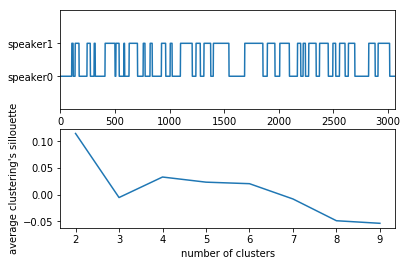

In [10]:
r_full = aS.speakerDiarization("jj-eb-podcast.wav",n_speakers=-1,mt_step=1,plot_res=True)

In [12]:
import pandas as pd

df = pd.DataFrame({'speaker': r_full})
df.index.name = 'second'
df.head()

,speaker
second,
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0


In [29]:
import matplotlib.pyplot as plt

# calculate percentage of talk time
talk_time = (df.groupby(by='speaker').apply(lambda x: len(x))/df.shape[0]).to_list()
labels = ['JJ Reddick','Elton Brand']

fig1, ax1 = plt.subplots()
ax1.pie(talk_time, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.title('Talk Time by Speaker')
plt.show()


NameError: name 'df' is not defined

## References

- [Indices of repeating numbers](https://stackoverflow.com/questions/46083473/finding-starting-and-ending-index-of-consecutive-numbers-in-python)
- [Fisher Linear Semi-Discriminant Analysis for Speaker Diarization](https://ieeexplore.ieee.org/document/6171836?arnumber=6171836&abstractAccess=no&userType=inst)
- [pyAudioAnalysis](https://github.com/tyiannak/pyAudioAnalysis/)

## Extract Features

In [23]:
from scipy.signal import hilbert

analytic_signal = hilbert(y)
amplitude_envelope = np.abs(analytic_signal)

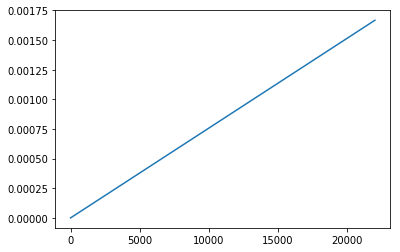

In [52]:
plt.plot(np.linspace(0, sr/len(y), sr))
plt.show()

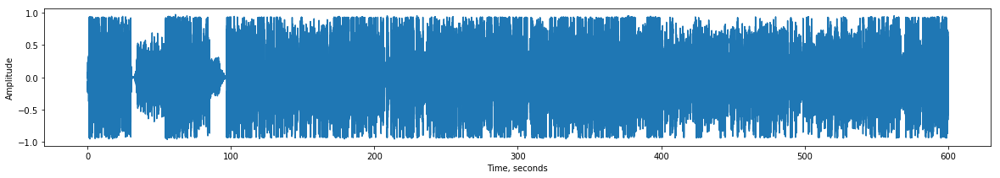

In [49]:
plt.figure(figsize=(20,3))
plt.plot([x/sr for x in range(0,len(y))],analytic_signal)
plt.ylabel("Amplitude")
plt.xlabel("Time, seconds")
plt.show()

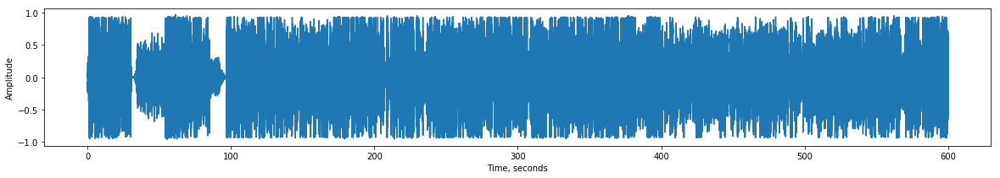

In [45]:
plt.figure(figsize=(20,3))
plt.plot([x/sr for x in range(0,len(y))],y)
plt.ylabel("Amplitude")
plt.xlabel("Time, seconds")
plt.show()

In [2]:
import librosa

y, sr = librosa.load('jj-eb-podcast.m4a',duration=300)

In [3]:
sr

22050

In [5]:
y.shape

(6615000,)

In [6]:
S = librosa.feature.melspectrogram(y=y, sr=sr)

In [7]:
S.shape

(128, 12920)

In [11]:
mfccs = librosa.feature.mfcc(S=librosa.power_to_db(S))
mfccs.shape

(20, 12920)

NameError: name 'S' is not defined

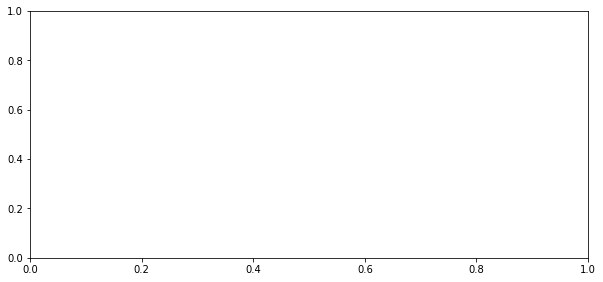

In [9]:
import matplotlib.pyplot as plt
import librosa.display

import numpy as np


plt.figure(figsize=(10,10))
plt.subplot(2, 1, 1)
librosa.display.specshow(librosa.power_to_db(S, ref = np.max), x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectogram')
plt.subplot(2, 1, 2)
librosa.display.specshow(mfccs, x_axis='time')
plt.colorbar()
plt.title('MFCC')
plt.tight_layout()

In [ ]:
matplotlib.

In [12]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
pca.fit(mfccs)

X = pca.components_
X

array([[-0.01494982, -0.01494982, -0.01494982, ..., -0.01494982,
        -0.01494982, -0.01494982],
       [-0.01372878, -0.01372878, -0.01372878, ..., -0.01372878,
        -0.01372878, -0.01372878]])

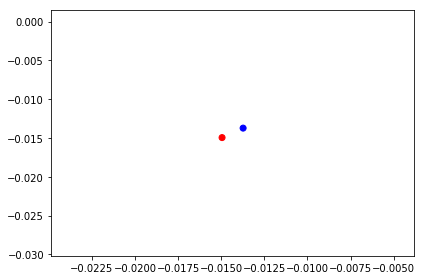

In [13]:
plt.scatter(X[:,0],X[:,1],color=['red','blue'])
plt.tight_layout()

## Cluster audio signal

In [10]:
from sklearn.cluster import KMeans
import numpy as np

import pandas as pd

kmeans = KMeans(n_clusters=2, random_state=0).fit(mfccs.T)
kmeans.labels_

NameError: name 'mfccs' is not defined

In [15]:
# get time intervals
onset_env = librosa.onset.onset_strength(y=y, sr=sr)
times = librosa.frames_to_time(range(len(onset_env)))
times
sum(onset_env)

25029.569817566495

In [16]:
# Voice owner by frame
frames = [x for x,z in enumerate(kmeans.labels_) if z == 0]
frames2 = list(set(range(len(times)-1)) - set(frames))

In [17]:
onset1 = onset_env
onset2 = onset1

onset1[frames] = 0
onset2[frames2] = 0

#onset1 = onset1 / onset1.max()
#onset2 = onset2 / onset2.max()

sum(onset2)

0.0

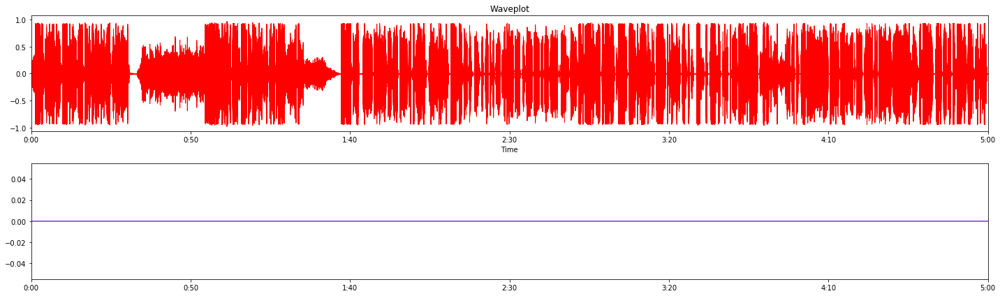

In [18]:
# plot
plt.figure(figsize=(20,6))
ax1 = plt.subplot(2, 1, 1)
librosa.display.waveplot(y,sr=sr, color='r')
plt.title('Waveplot')
plt.subplot(2, 1, 2, sharex=ax1)
plt.plot(times,onset1, alpha=0.5, label='Mean (mel)', color = 'r' )
plt.plot(times,onset2, alpha=0.5, label='Mean l)', color = 'b')
plt.tight_layout()

In [53]:
y_harmonic, y_percussive = librosa.effects.hpss(y)
y_harmonic

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

In [101]:
bounds = [x for x,z in enumerate(kmeans.labels_) if z == 0]
bound_times = librosa.frames_to_time(bounds, sr=sr)
bound_times

array([1.39319728e-01, 1.62539683e-01, 1.85759637e-01, ...,
       2.99374875e+02, 2.99398095e+02, 2.99421315e+02])

In [112]:
librosa.samples_to_frames([x  for x,z in enumerate(mfccs)])

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [204]:
filename = librosa.util.example_audio_file()
y, sr = librosa.load(filename)

In [127]:
mf = librosa.feature.mfcc(y=y, sr=sr)
mf.T.shape

(2647, 20)

In [132]:
color = mf.mean(0)
color = color/max(abs(color))
color

array([-1.        , -0.5655606 , -0.21613305, ..., -1.        ,
       -1.        , -1.        ])

In [239]:
onset_env = librosa.onset.onset_strength(y, sr=sr)
times = librosa.frames_to_time(range(len(onset_env)))
times


array([0.00000000e+00, 2.32199546e-02, 4.64399093e-02, ...,
       6.13935601e+01, 6.14167800e+01, 6.14400000e+01])

In [259]:

(2 + onset_env / onset_env.max())[list(set(range(len(times))) - set(frames))]

array([2., 2., 2., ..., 2., 2., 2.])

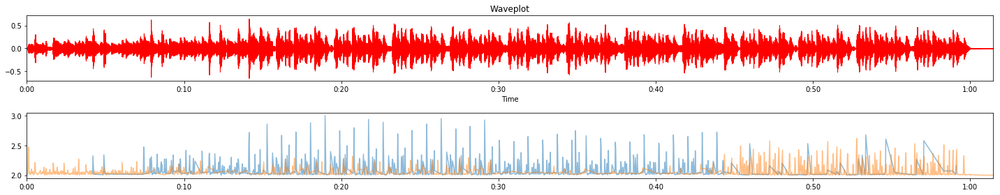

In [267]:



plt.figure(figsize=(20,4))
ax1 = plt.subplot(2, 1, 1)
librosa.display.waveplot(y,sr=sr, color='r')
plt.title('Waveplot')
plt.subplot(2, 1, 2, sharex=ax1)
plt.plot(times[frames],(2 + onset_env / onset_env.max())[frames] , alpha=0.5, label='Mean (mel)' )
plt.plot(times[frames2],(2 + onset_env / onset_env.max())[frames2] , alpha=0.5, label='Mean l)' )
plt.tight_layout()

In [158]:
tempo, beats = librosa.beat.beat_track(y, sr=sr)
beat_times = librosa.frames_to_time(beats, sr=sr)
beat_times

array([ 0.11609977,  0.55727891,  0.99845805,  1.46285714,  1.92725624,
        2.39165533,  2.83283447,  3.29723356,  3.76163265,  4.22603175,
        4.69043084,  5.15482993,  5.61922902,  6.08362812,  6.52480726,
        6.98920635,  7.45360544,  7.91800454,  8.38240363,  8.87002268,
        9.31120181,  9.77560091, 10.24      , 10.70439909, 11.14557823,
       11.60997732, 12.07437642, 12.53877551, 13.0031746 , 13.4675737 ,
       13.93197279, 14.39637188, 14.83755102, 15.27873016, 15.74312925,
       16.20752834, 16.67192744, 17.11310658, 17.60072562, 18.04190476,
       18.52952381, 18.97070295, 19.43510204, 19.89950113, 20.36390023,
       20.80507937, 21.29269841, 21.73387755, 22.2214966 , 22.66267574,
       23.12707483, 23.59147392, 24.05587302, 24.49705215, 24.96145125,
       25.42585034, 25.91346939, 26.35464853, 26.81904762, 27.28344671,
       27.7478458 , 28.18902494, 28.65342404, 29.11782313, 29.60544218,
       30.06984127, 30.53424036, 30.9754195 , 31.43981859, 31.88

In [191]:
onset_env.shape

(2647,)

## pyAudioAnalysis

In [2]:
from pyAudioAnalysis import audioBasicIO as aIO
from pyAudioAnalysis import audioSegmentation as aS


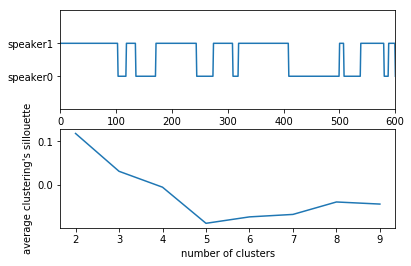

In [23]:
r = aS.speakerDiarization("audio/out000.wav",-1,mt_step=1,plot_res=True)

In [25]:
len(r)

601